#Agenda
* Parallelism
* try out two category


**To start with we are going to observe only 20 images**

In [2]:
from pathlib import Path
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from PIL import Image
import numpy as np
from shapely.geometry import Polygon, Point
import matplotlib.patches as patches# Create figure and axes
# Swimmer data set class imbalance
import glob
import os
import swifter

In [78]:
%%time
# 2 category distribution
root_path =  r'/Users/krish/ljmu/1.data/afo/'
class_0count = 0
class_1count = 0
for labname in glob.glob(root_path+'2categories/*.txt'):
    labels = pd.read_csv(labname, sep=' ', names=['class', 'x1', 'y1', 'w', 'h'])
    class_0count +=labels[labels['class']==0].shape[0]
    class_1count +=labels[labels['class']==1].shape[0]

print('the number of small objects', class_0count)
print('the number of large objects', class_1count)


the number of small objects 33761
the number of large objects 6230
CPU times: user 2.37 s, sys: 153 ms, total: 2.53 s
Wall time: 3.25 s


In [79]:
import multiprocessing
from joblib import Parallel, delayed
num_cores = multiprocessing.cpu_count()

In [80]:

def counter(label_name,class_0count,class_1count):

    labels = pd.read_csv(label_name, sep=' ', names=['class', 'x1', 'y1', 'w', 'h'])
    class_0count +=labels[labels['class']==0].shape[0]
    class_1count +=labels[labels['class']==1].shape[0]
    return [class_0count,class_1count]
    

In [81]:
%%time
# 2 category distribution parallel computing
root_path =  r'/Users/krish/ljmu/1.data/afo/'

res = Parallel(n_jobs=num_cores)(delayed(counter)(labname,0,0) for labname in glob.glob(root_path+'2categories/*.txt'))
c0 = 0
c1 = 0
for i in res:
    c0 += i[0]
    c1 += i[1]

print('the number of small objects', c0)
print('the number of large objects', c1)

the number of small objects 33761
the number of large objects 6230
CPU times: user 286 ms, sys: 39.2 ms, total: 325 ms
Wall time: 700 ms


In [82]:
#### Parallelism tested

In [123]:
slice_size = 500
newpath = '/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/'

falsepath = '/Users/krish/ljmu/1.data/afo/tiledv4/train/false/'
#creating a new directory called pythondirectory
Path(newpath).mkdir(parents=True, exist_ok=True)
Path(falsepath).mkdir(parents=True, exist_ok=True)

def tiler3(imname):
    im = Image.open(imname)
    imr = np.array(im, dtype=np.uint8)
    height = imr.shape[0]
    width = imr.shape[1]
    labname = imname.split('/')[-1].replace('.jpg', '.txt')
    labels = pd.read_csv(root_path+'2categories/'+labname, sep=' ', names=['class', 'x1', 'y1', 'w', 'h'])
    labels = labels[labels['class']==0] # Only taking into consideration small objects
    
    # we need to rescale coordinates from 0-1 to real image height and width
    labels[['x1', 'w']] = labels[['x1', 'w']] * width
    labels[['y1', 'h']] = labels[['y1', 'h']] * height
    
    boxes = []
    #print(labels)
    # convert bounding boxes to shapely polygons. We need to invert Y and find polygon vertices from center points
    for row in labels.iterrows():
        x1 = row[1]['x1'] - row[1]['w']/2
        y1 = (height - row[1]['y1']) - row[1]['h']/2
        x2 = row[1]['x1'] + row[1]['w']/2
        y2 = (height - row[1]['y1']) + row[1]['h']/2

        boxes.append((int(row[1]['class']), Polygon([(x1, y1), (x2, y1), (x2, y2), (x1, y2)])))
    
    counter = 0
    print('Image:', imname)
    # create tiles and find intersection with bounding boxes for each tile
    fig, axs = plt.subplots((height // slice_size)+int(bool(height%slice_size)),(width // slice_size)+int(bool(width%slice_size)))    
    for i in range((height // slice_size)+int(bool(height%slice_size))):
        for j in range((width // slice_size)+int(bool(width%slice_size))):
            
            if (i == (height // slice_size)) and (j != (width//slice_size)):
                sliced = imr[height - slice_size:height, j*slice_size:(j+1)*slice_size]
                x1 = width - slice_size
                y1 = height - (i*slice_size)
                x2 = width
                y2 = (height - (i+1)*slice_size) + 1
                
            elif (i != (height // slice_size)) and (j == (width//slice_size)):
                sliced = imr[i*slice_size:(i+1)*slice_size, width - slice_size:width]
                x1 = j*slice_size
                y1 = height - (height - slice_size)
                x2 = ((j+1)*slice_size) - 1
                y2 = 0
                
            elif (i == (height // slice_size)) and (j == (width//slice_size)):
                sliced = imr[height - slice_size:height, width - slice_size:width]
                x1 = width - slice_size
                y1 = height - (height - slice_size)
                x2 = width
                y2 = 0
            
            elif (i != (height // slice_size)) and (j != (width//slice_size)) :
                sliced = imr[i*slice_size:(i+1)*slice_size, j*slice_size:(j+1)*slice_size]
                x1 = j*slice_size
                y1 = height - (i*slice_size)
                x2 = ((j+1)*slice_size) - 1
                y2 = (height - (i+1)*slice_size) + 1
            
            pol = Polygon([(x1, y1), (x2, y1), (x2, y2), (x1, y2)])
            imsaved = False
            slice_labels = []
            
            
            
            for box in boxes:
                if pol.intersects(box[1]):
                    inter = pol.intersection(box[1])        
                    
                    if not imsaved:
                      
                        sliced_im = Image.fromarray(sliced)
                        filename = imname.split('/')[-1]
                        ##filename = imname
                        slice_path = newpath + filename.replace('.jpg', f'_{i}_{j}.jpg')
                        
                        slice_labels_path = newpath + filename.replace('.jpg', f'_{i}_{j}.txt')
                        
                        print(slice_path)
                        #print('hi')
                        sliced_im.save(slice_path)
                        imsaved = True                    
                    
                    # get the smallest polygon (with sides parallel to the coordinate axes) that contains the intersection
                    new_box = inter.envelope 
                    
                    # get central point for the new bounding box 
                    centre = new_box.centroid
                    
                    # get coordinates of polygon vertices
                    x, y = new_box.exterior.coords.xy
                    
                    # get bounding box width and height normalized to slice size
                    new_width = (max(x) - min(x)) / slice_size
                    new_height = (max(y) - min(y)) / slice_size
                    
                    # we have to normalize central x and invert y for yolo format
                    new_x = (centre.coords.xy[0][0] - x1) / slice_size
                    new_y = (y1 - centre.coords.xy[1][0]) / slice_size
                    
                    counter += 1

                    slice_labels.append([box[0], new_x, new_y, new_width, new_height])
                    
            if len(slice_labels) > 0:
                slice_df = pd.DataFrame(slice_labels, columns=['class', 'x1', 'y1', 'w', 'h'])
                #print(slice_df)
                slice_df.to_csv(slice_labels_path, sep=' ', index=False, header=False, float_format='%.6f')
            
            # if there are no bounding boxes intersect current tile, save this tile to a separate folder 
            if not imsaved:
                sliced = imr[i*slice_size:(i+1)*slice_size, j*slice_size:(j+1)*slice_size]
                sliced_im = Image.fromarray(sliced)
                filename = imname.split('/')[-1]
                #filename = imname
                slice_path = falsepath + filename.replace('.jpg', f'_{i}_{j}.jpg')                

                sliced_im.save(slice_path)
                print('Slice without boxes saved')
                imsaved = True
    plt.close()

In [124]:
# imname = root_path+'images/a_304.jpg'
# tiler3(imname)

In [125]:
%%time
dont run
Parallel(n_jobs=num_cores)(delayed(tiler3)(imname) for imname in glob.glob(root_path+'images/*.jpg'))

Image: /Users/krish/ljmu/1.data/afo/images/b1_37.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_37_0_0.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_37_1_1.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_37_1_2.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_37_1_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_37_1_4.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_37_2_1.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_37_2_2.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_37_2_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_37_2_4.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without box

Image: /Users/krish/ljmu/1.data/afo/images/b1_37.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_37_0_0.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_37_1_1.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_37_1_2.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_37_1_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_37_1_4.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_37_2_1.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_37_2_2.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_37_2_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_37_2_4.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without box

Image: /Users/krish/ljmu/1.data/afo/images/b1_23.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_23_0_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_23_0_4.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_23_0_5.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_23_0_6.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_23_1_2.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_23_1_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_23_1_4.jpg
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_23_1_6.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_23_2_2.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_23_2_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_23_2_4.jpg
Slice without boxes saved
S

Image: /Users/krish/ljmu/1.data/afo/images/r2_94.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/b1_37.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_37_0_0.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/U

Image: /Users/krish/ljmu/1.data/afo/images/r2_94.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/b1_211.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv

Image: /Users/krish/ljmu/1.data/afo/images/e_2.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_2_0_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_2_0_4.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_2_0_5.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_2_0_6.jpg
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_2_1_0.jpg
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_2_1_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_2_1_4.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_2_1_5.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_2_1_6.jpg
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_2_2_0.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_2_2_1.jpg
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_2_2_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts

Image: /Users/krish/ljmu/1.data/afo/images/b1_23.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_23_0_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_23_0_4.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_23_0_5.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_23_0_6.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_23_1_2.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_23_1_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_23_1_4.jpg
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_23_1_6.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_23_2_2.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_23_2_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_23_2_4.jpg
Slice without boxes saved
S

Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/w1_403.jpg
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/w1_403_0_1.jpg
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/w1_403_0_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/w1_403_0_4.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/w1_403_0_5.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/w1_403_1_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/w1_403_1_4.jpg
Slice without boxes saved
Slice without boxes saved
Slice wi

/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/d_418_1_6.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/d_418_2_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/d_418_2_4.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/d_418_2_5.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/d_418_2_6.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/d_430.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes sav

Slice without boxes savedSlice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/ev_363.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/ev_363_0_0.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/ev_363_0_1.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/ev_363_0_2.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/ev_363_0_3.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/ev_363_

Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/w1_198.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/w1_198_1_2.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
S

Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/d_356_1_1.jpg
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/d_356_1_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/d_356_1_4.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/d_356_2_2.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/d_356_2_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/d_356_2_4.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/d_356_3_2.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/d_356_3_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/d_356_3_4.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxe

Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_415_1_1.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_415_2_1.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_415_3_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_415_3_4.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice 

/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/c_114_2_3.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/c_114_3_2.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/c_114_3_3.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/s5_74.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without

Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/e_28.jpg
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_28_0_1.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_28_0_2.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_28_0_3.jpg
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_28_0_5.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_28_1_4.jpg
Sli

Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_94_3_1.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_94_3_2.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/s5_466.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes 


Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/r4_107_1_2.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/e_73.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_73_0_0.jpg
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_73_0_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_73_0_4.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_73_1_0.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_73_1_1.jpg
/Users/krish/ljmu/1

/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/s2_32_1_1.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/s2_32_1_2.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/s1_254.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/r3_184.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxe

Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/k3_86.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/k3_86_0_4.jpg
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/k3_86_1_1.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/z3_59.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes 

Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/r3_77.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice witho

Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/r3_225.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/a_1062.jpg
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_1062_0_1.jpg
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_1062_0_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train

Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/b1_113.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_113_0_7.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_113_1_7.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_113_2_6.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_113_2_7.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_113_3_0.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_113_3_1.jpg
/Users/krish/ljmu/1.data/afo/tiled

Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/k4_175.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/k4_175_0_4.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/k4_175_1_2.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/k4_175_1_3.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo

Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/d_444_2_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/d_444_2_4.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/d_444_2_5.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/d_444_3_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/d_444_3_4.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/a_449.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes sav

Slice without boxes saved/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_74_1_5.jpg
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_74_2_0.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_74_2_1.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_74_2_2.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_74_2_3.jpg
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_74_2_5.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_74_3_2.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_74_3_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_74_3_4.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_74_3_5.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes s

/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_313_3_0.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/e_60.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_60_0_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_60_0_4.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_60_0_5.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_60_0_6.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_60_0_7.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e

Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/b1_289.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_289_1_1.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_289_2_3.jpg
/Users/krish/ljmu/

Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/s1_70.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/s5_307.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice wit

/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_78_2_2.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_78_2_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_78_2_4.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_78_3_2.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_78_3_3.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/z2_5.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes save

Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/b1_67.jpg
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_67_0_2.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_67_1_1.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_67_1_2.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_67_1_3.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_67_2_1.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_


Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/s2_199_1_0.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/s2_199_1_1.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/k3_61.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/k3_61_1_2.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/k3_61_1_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/k3_61_1_4.jpg
Slice without boxes saved
Slice without boxes 

Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/i1_15.jpg
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/i1_15_0_2.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/i1_15_1_2.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/i1_15_1_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/i1_15_1_4.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/s2_370.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Sli

/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_43_3_2.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_43_3_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_43_3_4.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_43_3_5.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_43_3_6.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_43_3_7.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_43_4_7.jpg
Image: /Users/krish/ljmu/1.data/afo/images/e_94.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_94_0_0.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_94_0_1.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_94_0_2.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/e_94_0_7.jpg
/Users/krish/

Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/k4_181.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/k4_181_0_4.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/k4_181_1_2.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/b1_137.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without bo

/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_1085_0_5.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_1085_1_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_1085_1_4.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_1085_1_5.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_1085_1_6.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_1085_2_4.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_1085_2_5.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
S

Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/s1_106.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/s1_106_1_2.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/w1_483.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved

Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/b1_147.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_147_1_2.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_147_1_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_147_1_4.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_147_1_5.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_147_1_6.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/b1_147_2_3.jpg
/Users/krish/ljmu/1.data/afo/tiled

/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/d_417_2_4.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/d_417_2_5.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/d_417_2_6.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/a_1208.jpg
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_1208_0_2.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_1208_0_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_1208_0_4.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_1208_0_5.jpg
/Users/krish/ljmu/1.data/afo

Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/a_1220.jpg
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_1220_0_2.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_1220_0_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_1220_0_4.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_1220_0_5.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_1220_0_6.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_1220_1_2.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_1220_1_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_1220_1_4.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_1220_1_5.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_1220_1_6.jp

Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/f_116.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/f_116_0_0.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/f_116_0_1.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/f_116_0_2.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/f_116_0_3.jpg
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/f_116_0_5.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/f_116_0_6.jpg
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/f_116_1_0.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/f_116_1_1.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/f_116_1_2.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/f_116_1_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/f_116_1_4.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/f_116_1_5.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/f_116_1_6.jpg
Slice witho

/Users/krish/ljmu/1.data/afo/images/s2_274.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/s5_47.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without bo

Slice without boxes saved/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_383_3_4.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_383_3_5.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/s1_37.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/s5_368.jpg
Slice without boxes 

Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/s2_102_1_0.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/s5_383.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/s5_383_1_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/s5_383_1_4.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /U

CPU times: user 14.6 s, sys: 2.82 s, total: 17.5 s
Wall time: 6min 43s


[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,


Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/a_1230.jpg
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_1230_0_1.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_1230_0_2.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_1230_0_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_1230_0_4.jpg

Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/a_422.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_422_2_1.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Sli

Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/f_112_0_6.jpg
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/f_112_1_0.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/f_112_1_1.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/f_112_1_2.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/f_112_1_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/f_112_1_4.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/f_112_1_5.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/f_112_1_6.jpg
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/f_112_2_1.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/f_112_2_2.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/f_112_2_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/f_112_2_4.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/f_112_2_5.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/f_112_2_6.jpg
Slice without boxes saved
Slic

Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/s2_76.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/i

Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/d_349_3_0.jpg
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/d_349_3_3.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
Image: /Users/krish/ljmu/1.data/afo/images/a_1032.jpg
Slice without boxes saved
Slice without boxes saved
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_1032_0_3.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_1032_0_4.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_1032_0_5.jpg
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_1032_0_6.jpg
Slice without boxes saved
/Users/krish/ljmu/1.data/afo/tiledv4/train/ts/a_1032_1_0.jpg
Slice without boxes saved
/

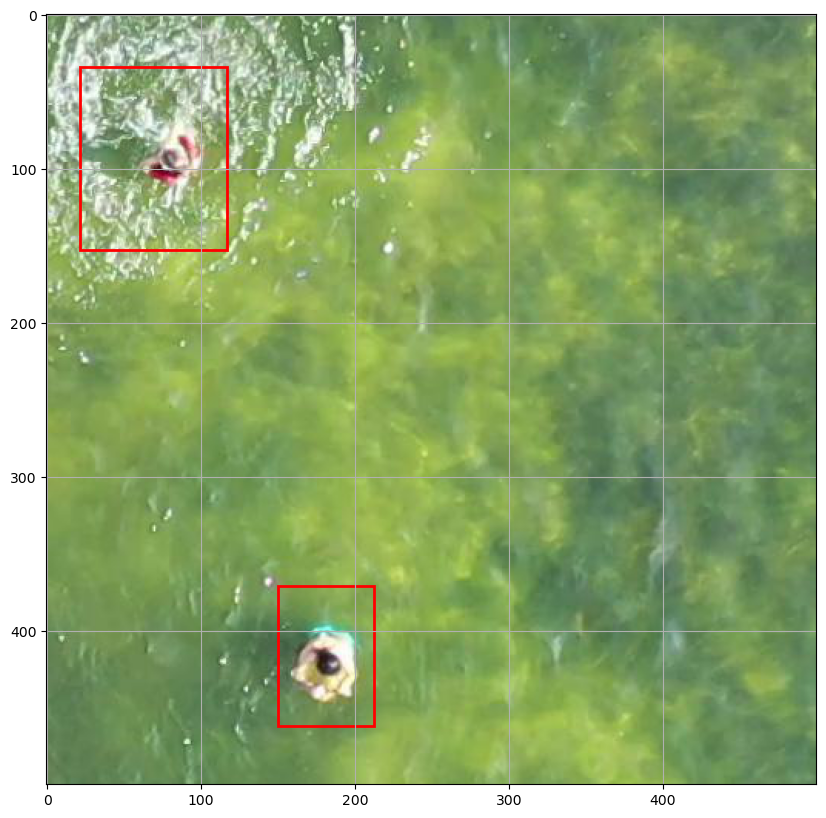

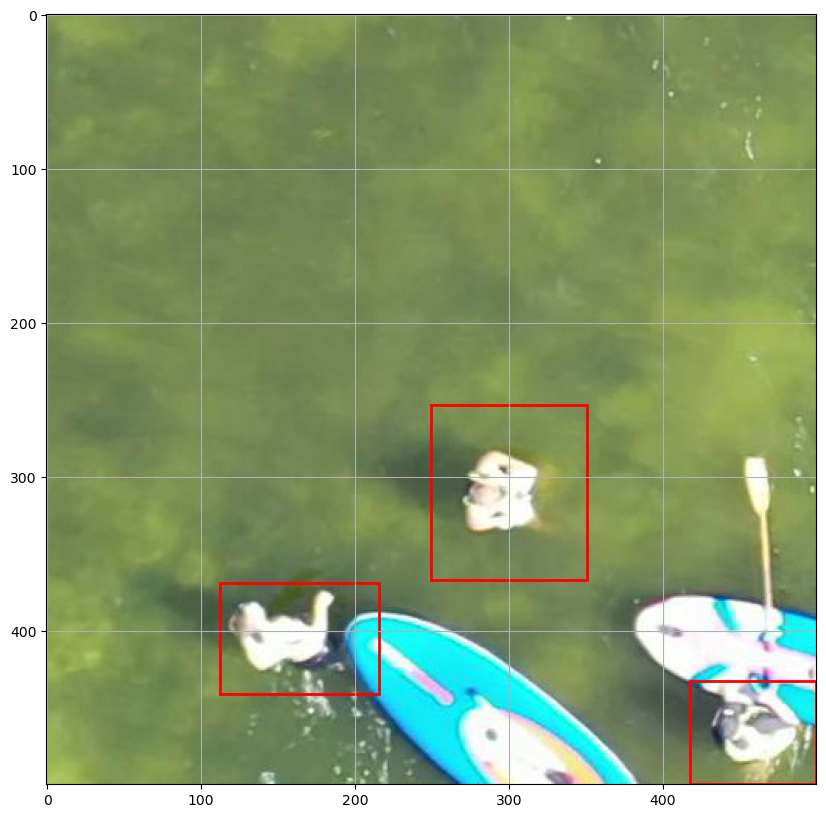

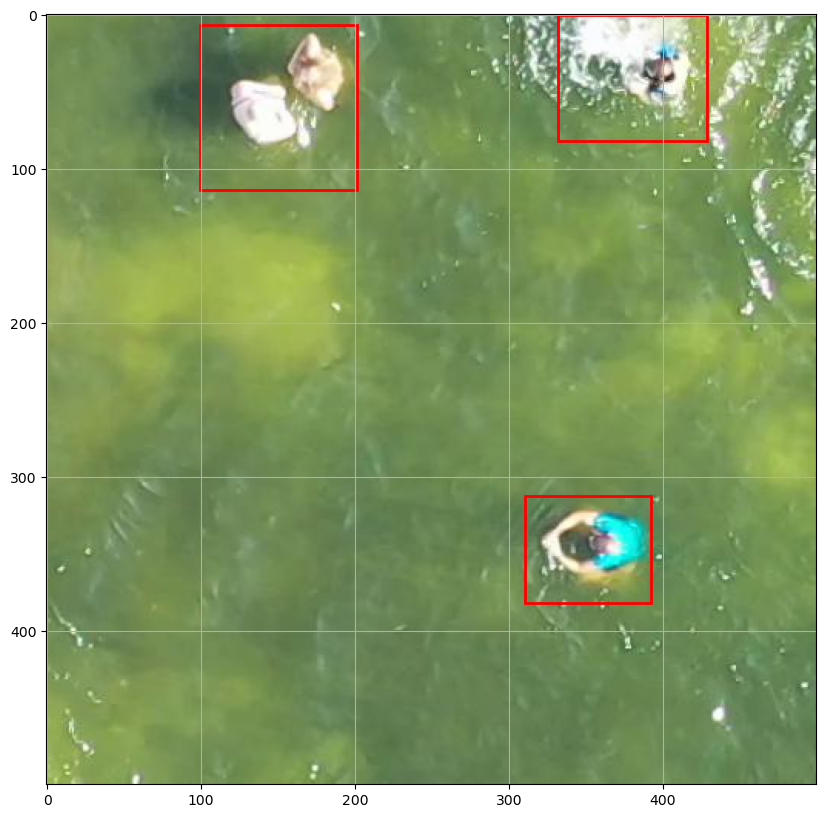

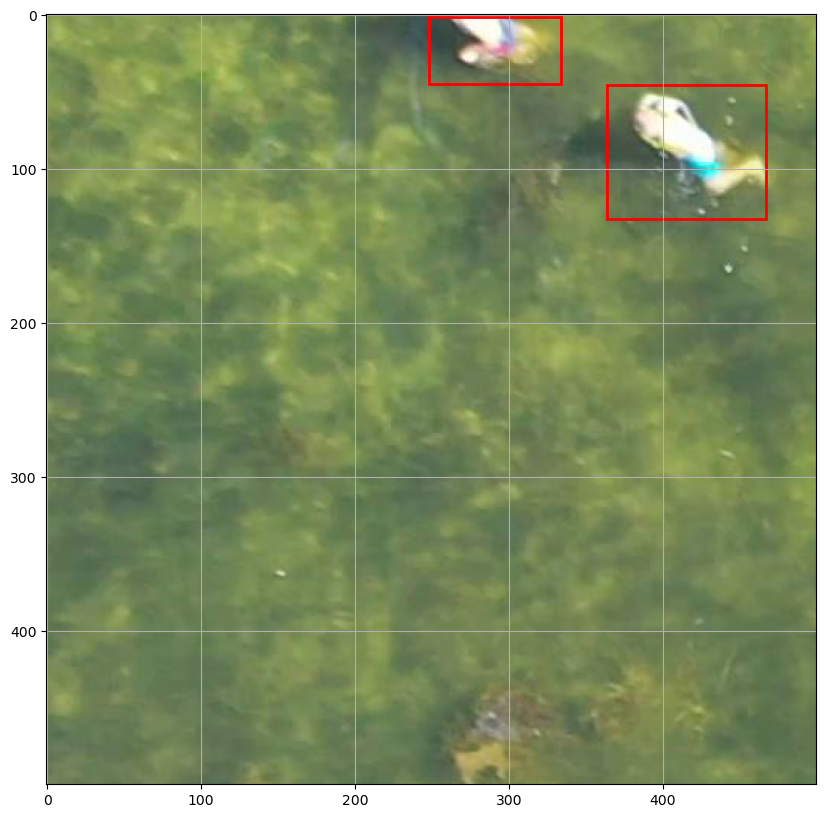

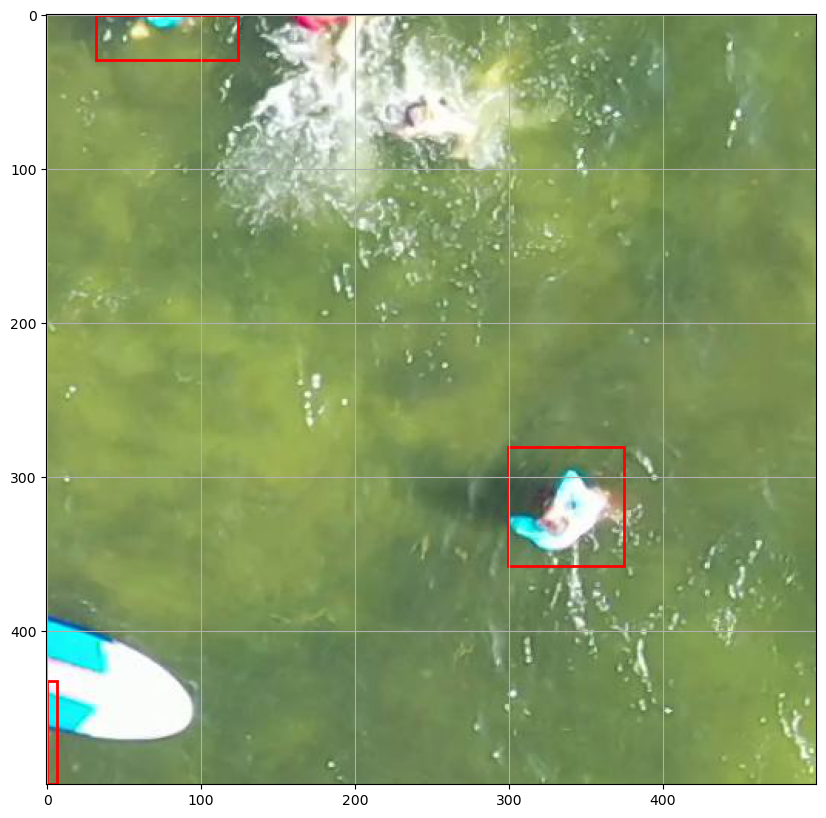

/var/folders/zk/p2gyqg915639vx6xr9xbs9cm0000gn/T/ipykernel_55968/3686379391.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_scaled[['x1', 'w']] = df_scaled[['x1', 'w']] * imr.shape[1]
/var/folders/zk/p2gyqg915639vx6xr9xbs9cm0000gn/T/ipykernel_55968/3686379391.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_scaled[['y1', 'h']] = df_scaled[['y1', 'h']] * imr.shape[0]


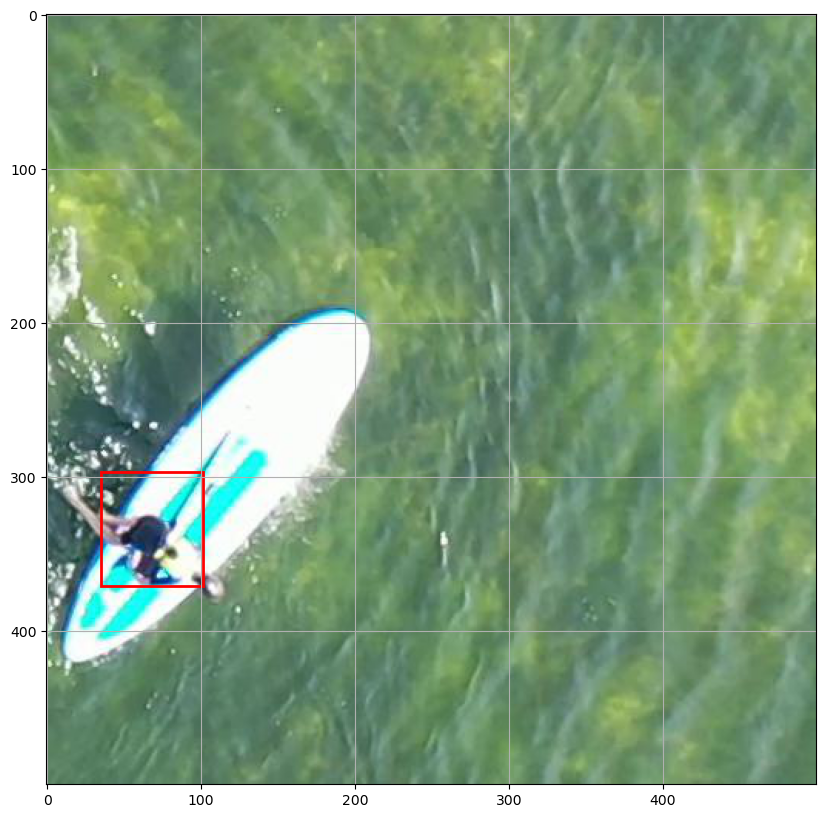

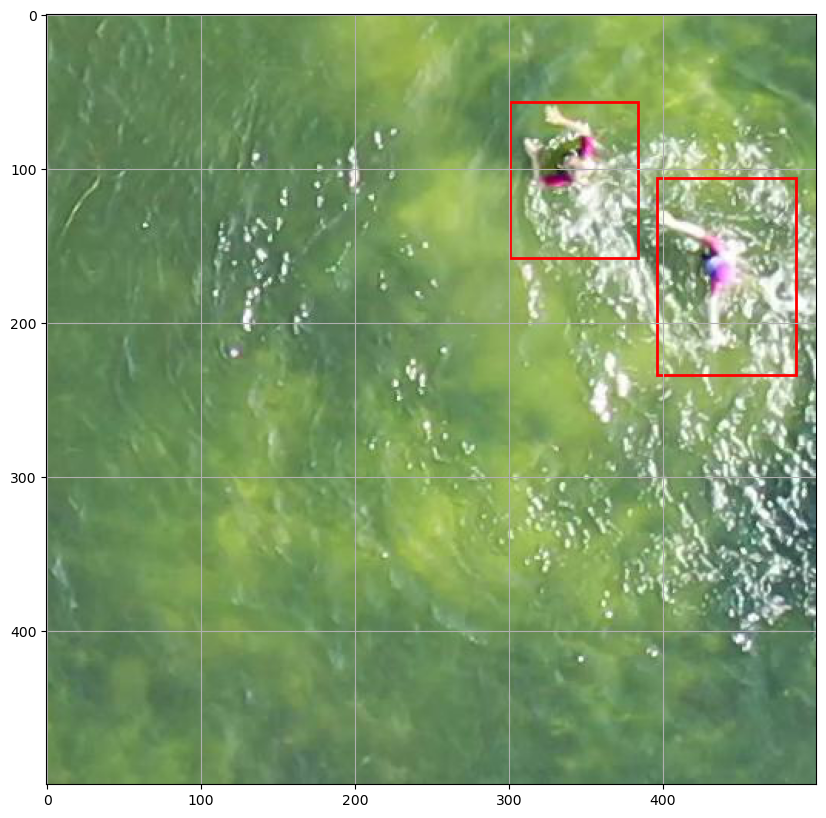

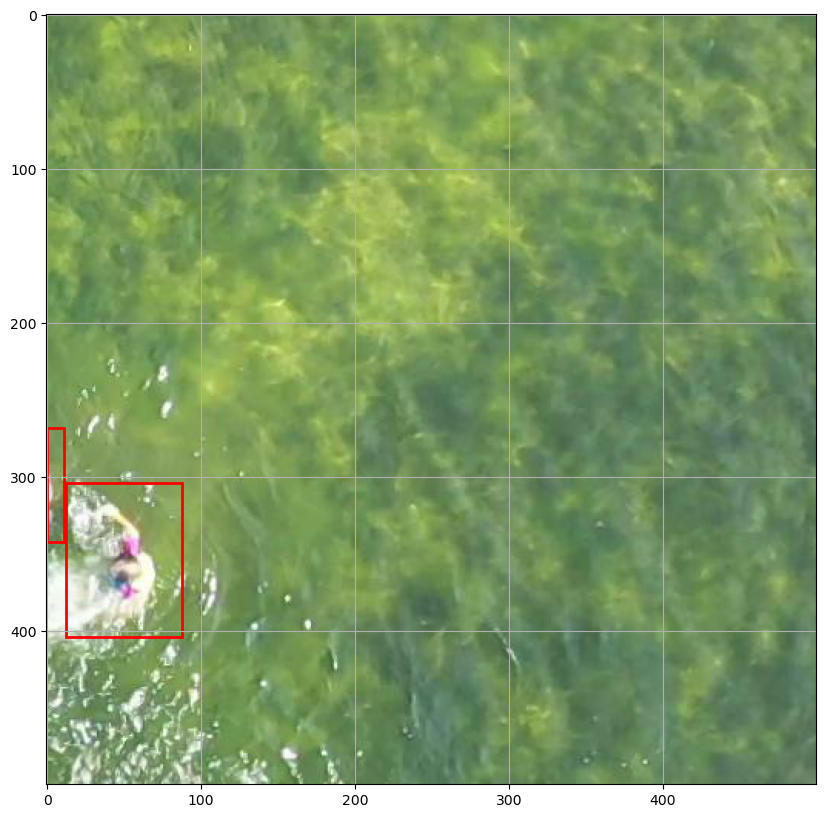

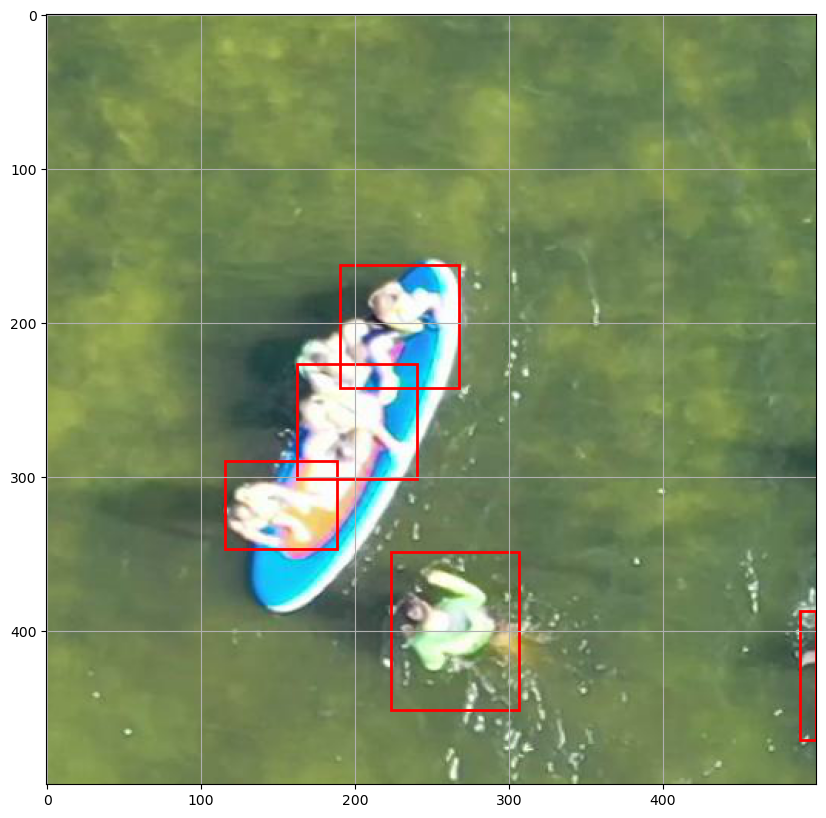

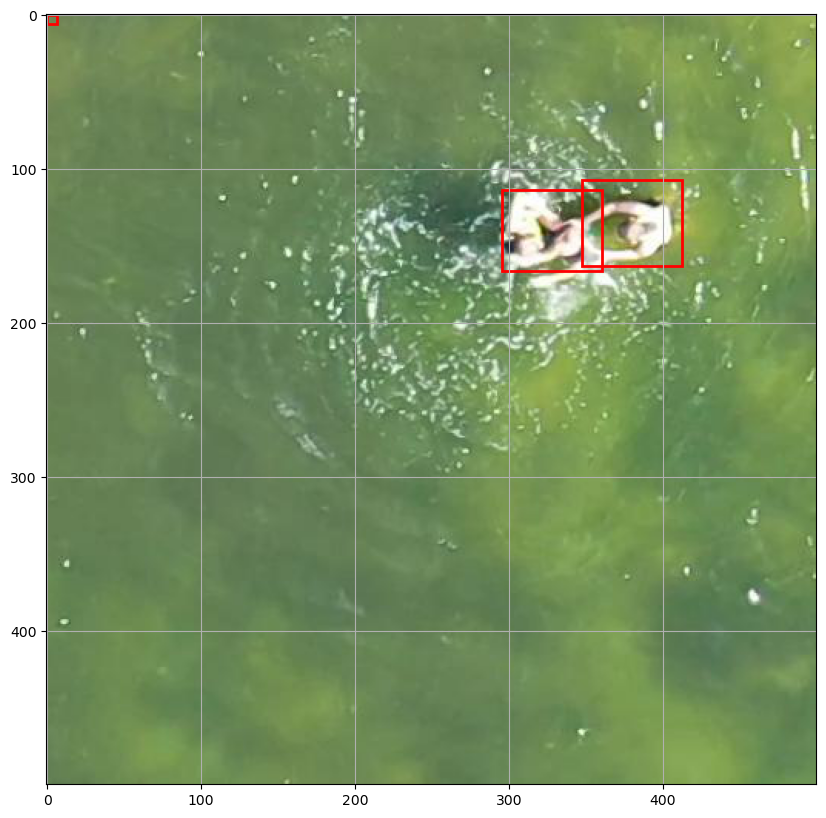

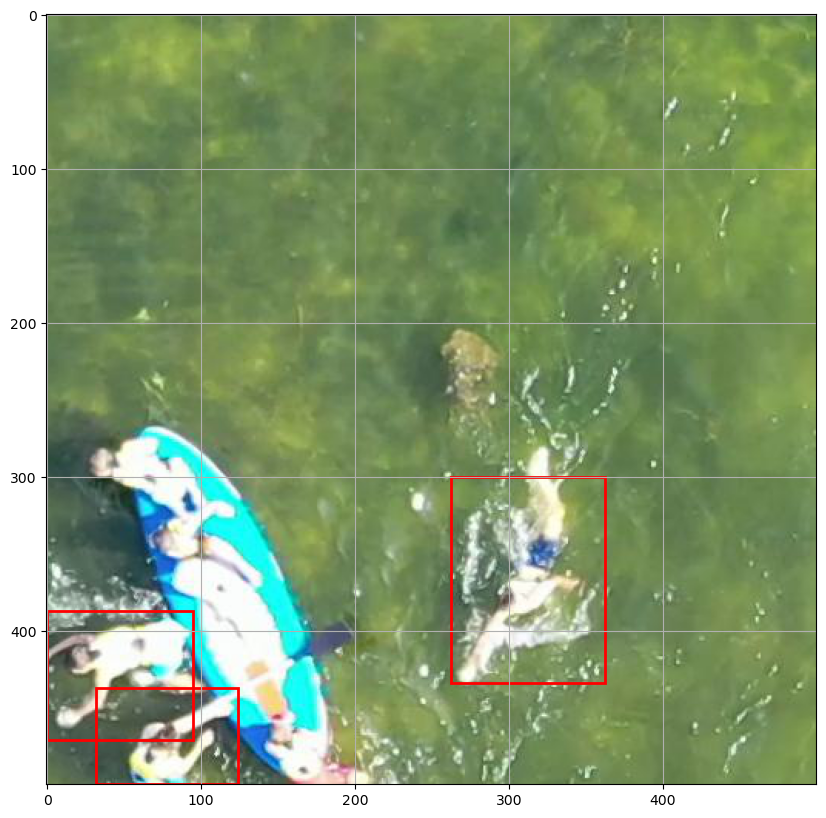

/var/folders/zk/p2gyqg915639vx6xr9xbs9cm0000gn/T/ipykernel_55968/3686379391.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_scaled[['x1', 'w']] = df_scaled[['x1', 'w']] * imr.shape[1]
/var/folders/zk/p2gyqg915639vx6xr9xbs9cm0000gn/T/ipykernel_55968/3686379391.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_scaled[['y1', 'h']] = df_scaled[['y1', 'h']] * imr.shape[0]


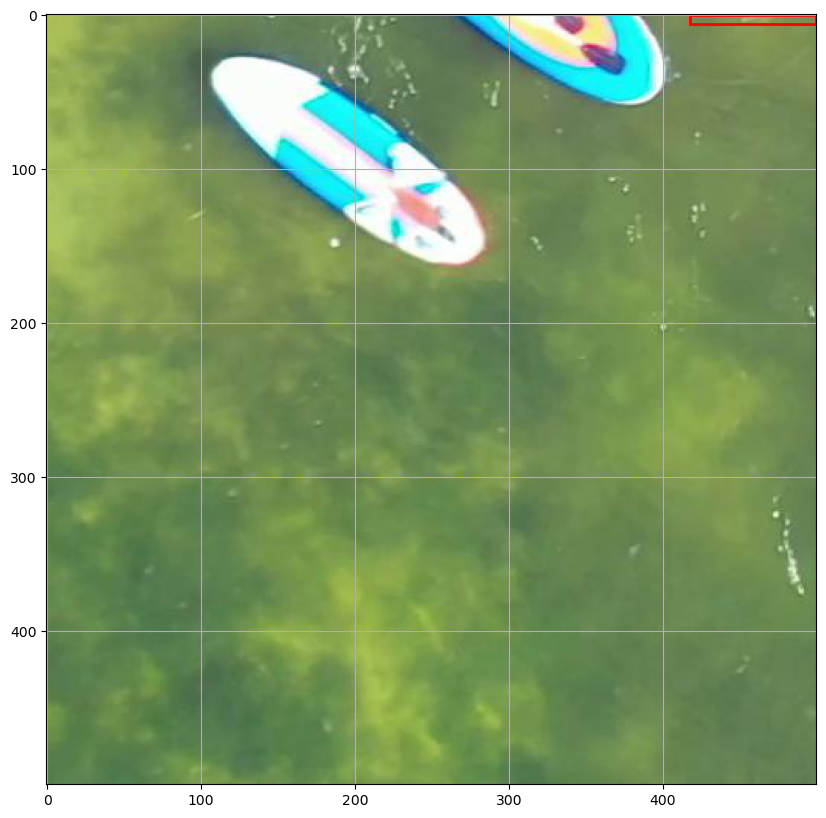

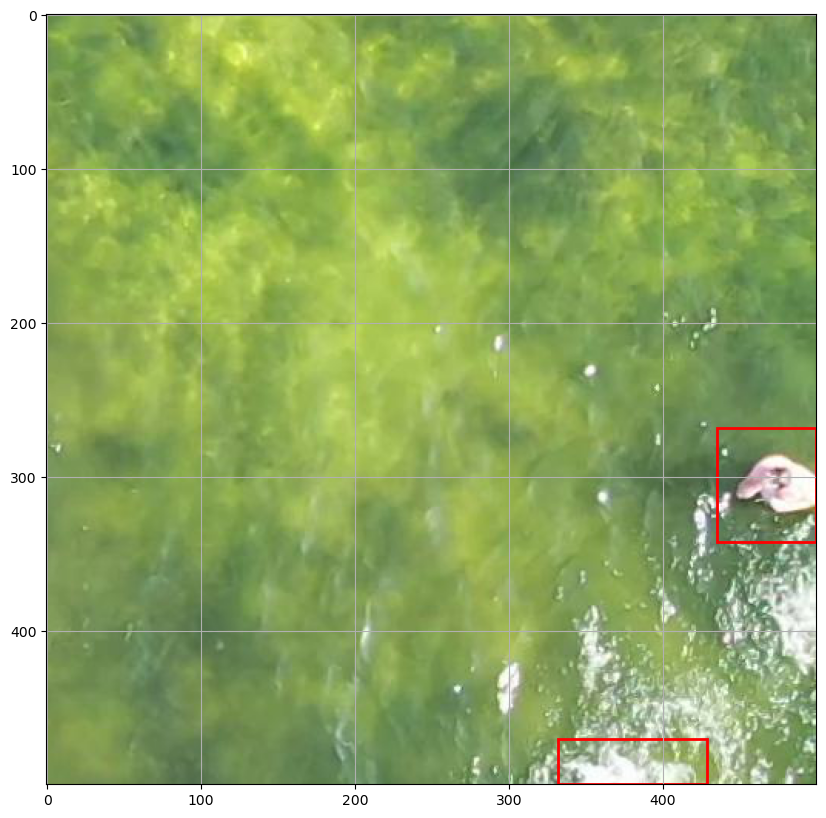

/var/folders/zk/p2gyqg915639vx6xr9xbs9cm0000gn/T/ipykernel_55968/3686379391.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_scaled[['x1', 'w']] = df_scaled[['x1', 'w']] * imr.shape[1]
/var/folders/zk/p2gyqg915639vx6xr9xbs9cm0000gn/T/ipykernel_55968/3686379391.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_scaled[['y1', 'h']] = df_scaled[['y1', 'h']] * imr.shape[0]


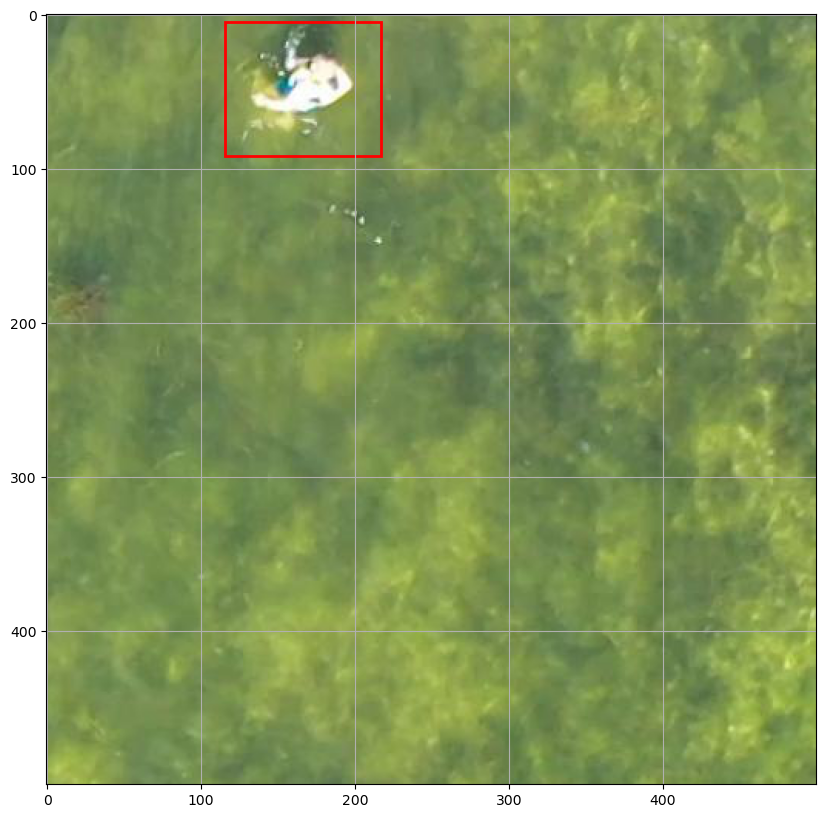

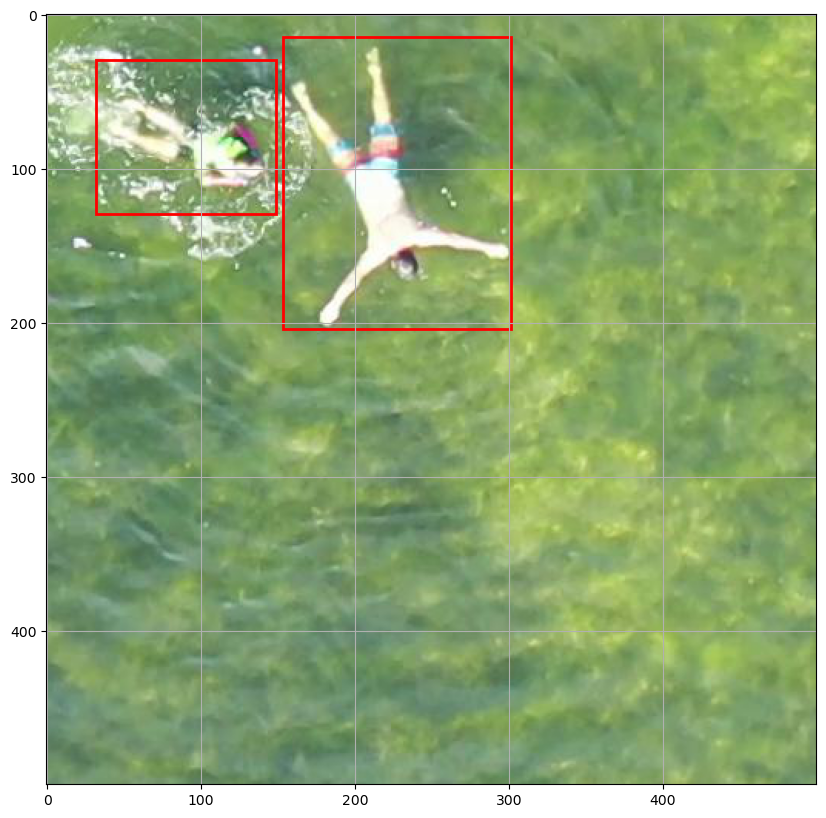

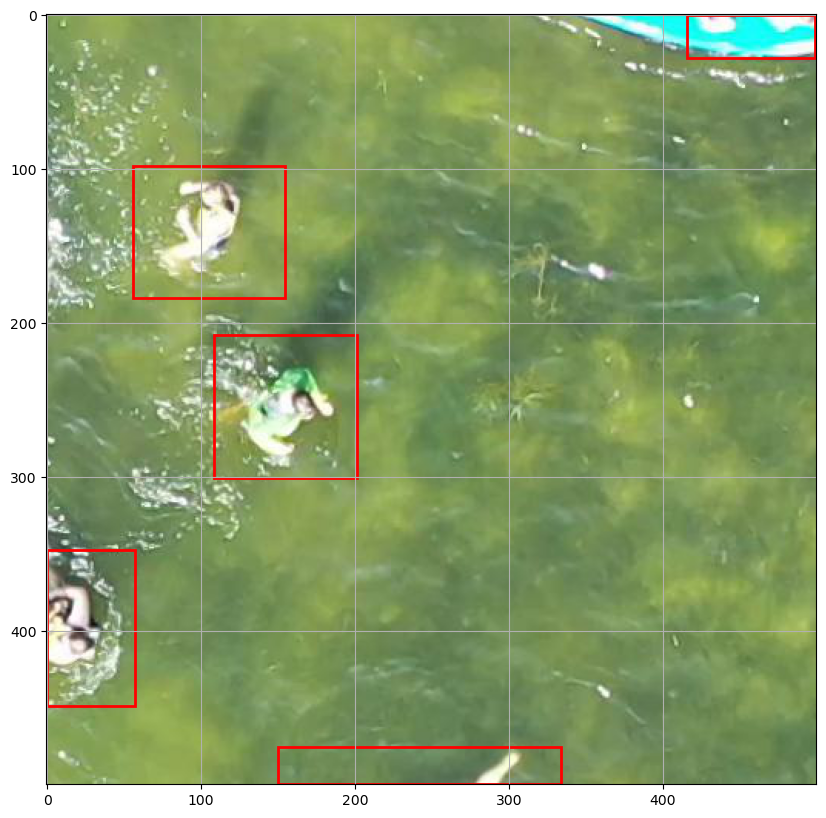

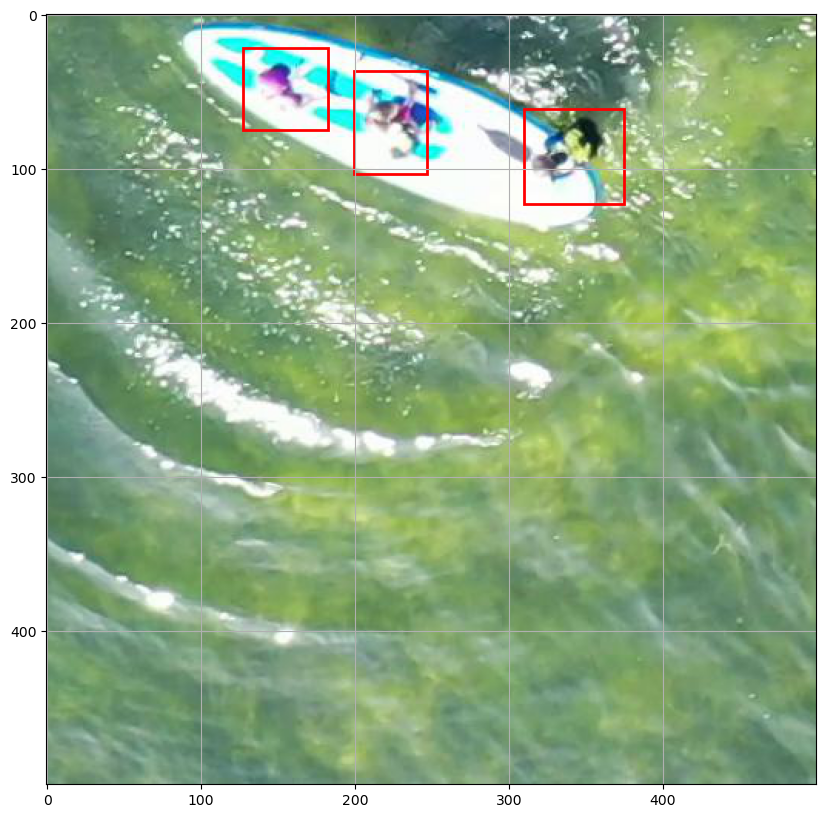

/var/folders/zk/p2gyqg915639vx6xr9xbs9cm0000gn/T/ipykernel_55968/3686379391.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_scaled[['x1', 'w']] = df_scaled[['x1', 'w']] * imr.shape[1]
/var/folders/zk/p2gyqg915639vx6xr9xbs9cm0000gn/T/ipykernel_55968/3686379391.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_scaled[['y1', 'h']] = df_scaled[['y1', 'h']] * imr.shape[0]


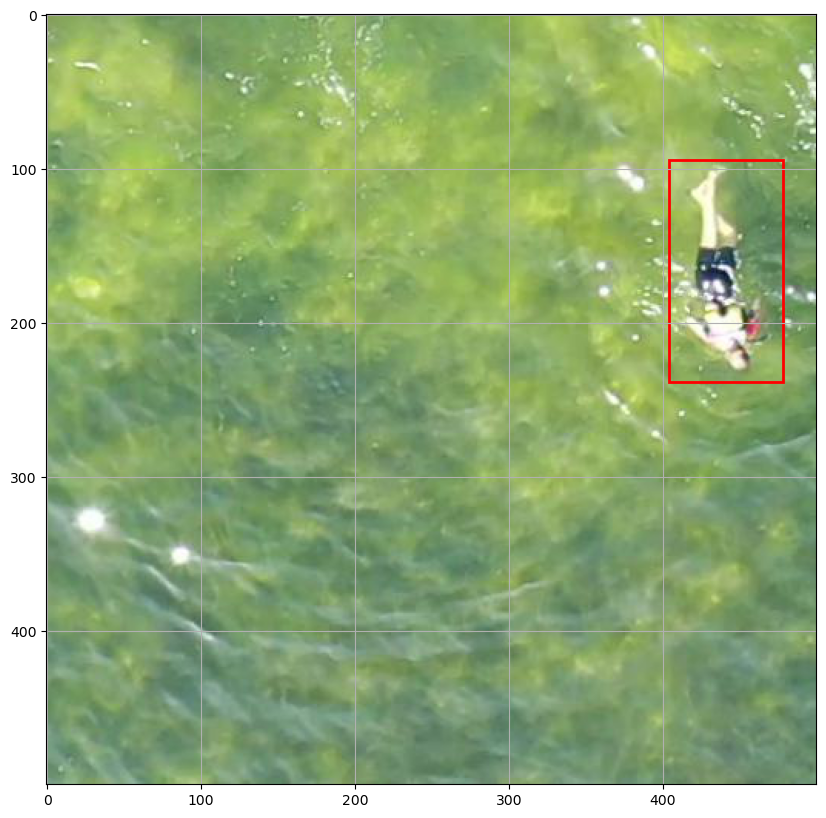

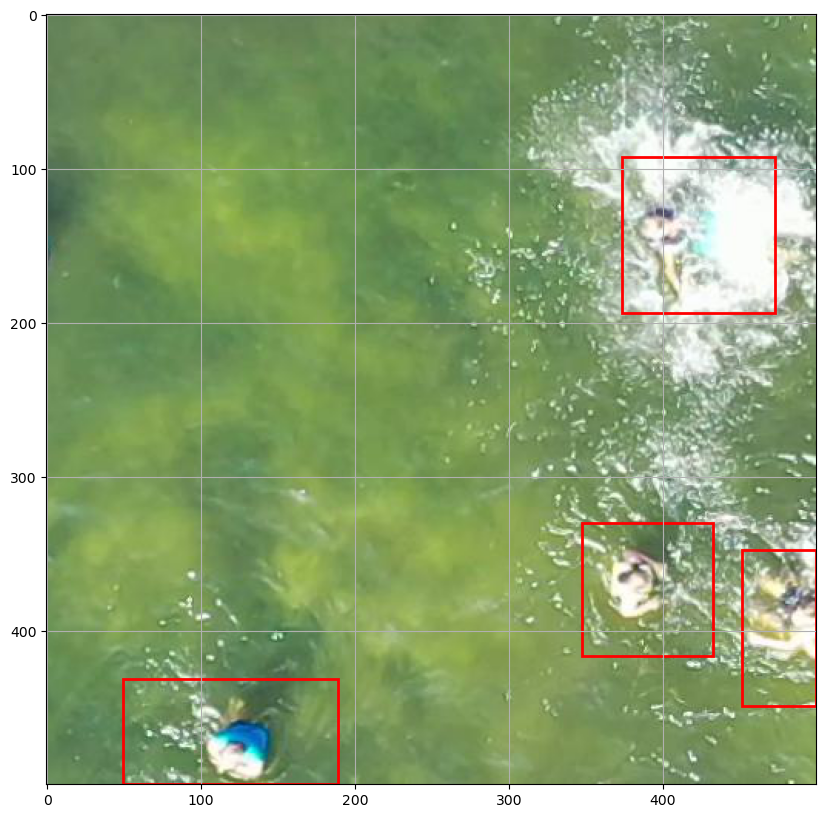

/var/folders/zk/p2gyqg915639vx6xr9xbs9cm0000gn/T/ipykernel_55968/3686379391.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_scaled[['x1', 'w']] = df_scaled[['x1', 'w']] * imr.shape[1]
/var/folders/zk/p2gyqg915639vx6xr9xbs9cm0000gn/T/ipykernel_55968/3686379391.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_scaled[['y1', 'h']] = df_scaled[['y1', 'h']] * imr.shape[0]


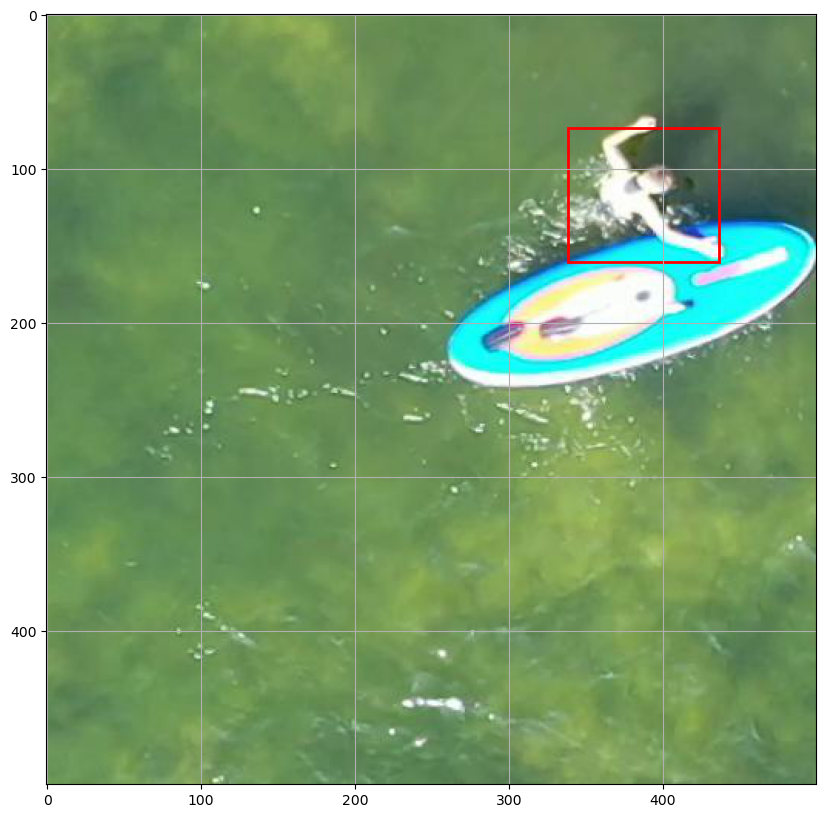

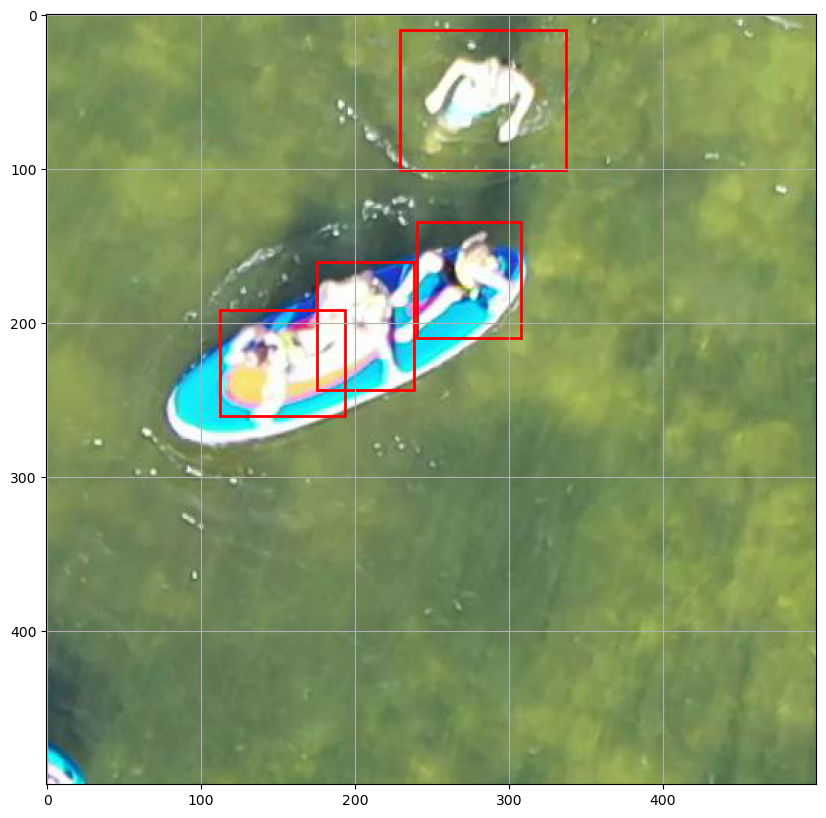

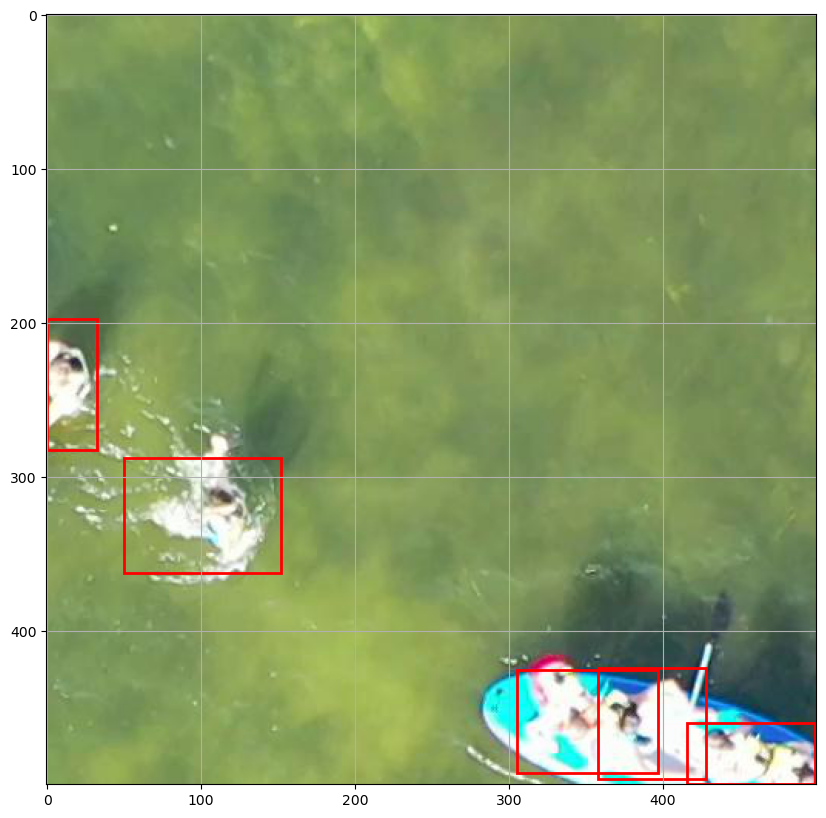

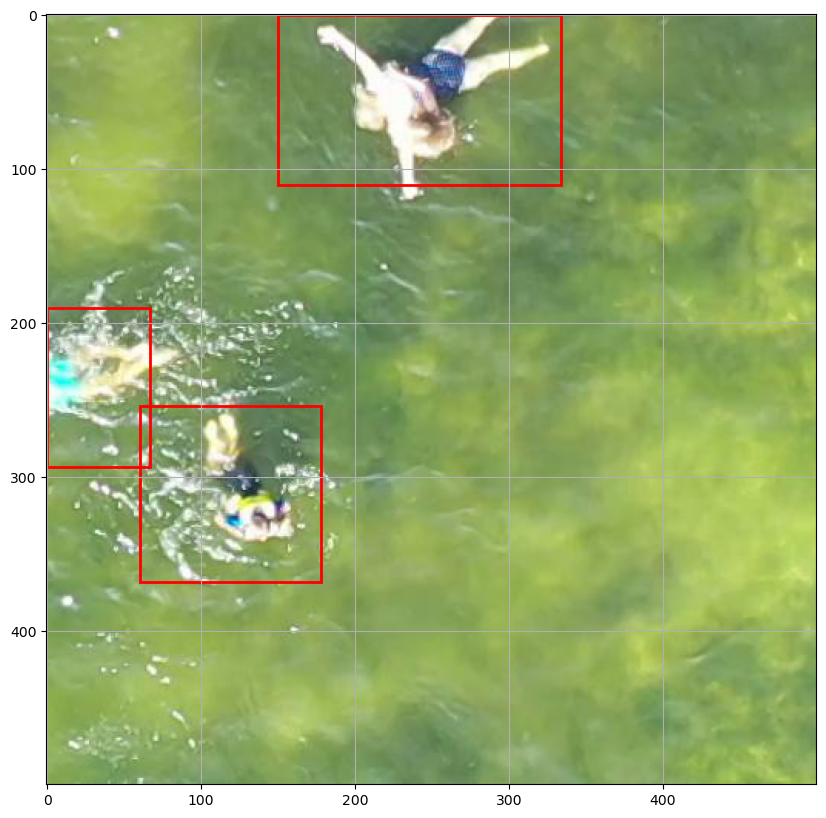

/var/folders/zk/p2gyqg915639vx6xr9xbs9cm0000gn/T/ipykernel_55968/3686379391.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_scaled[['x1', 'w']] = df_scaled[['x1', 'w']] * imr.shape[1]
/var/folders/zk/p2gyqg915639vx6xr9xbs9cm0000gn/T/ipykernel_55968/3686379391.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_scaled[['y1', 'h']] = df_scaled[['y1', 'h']] * imr.shape[0]


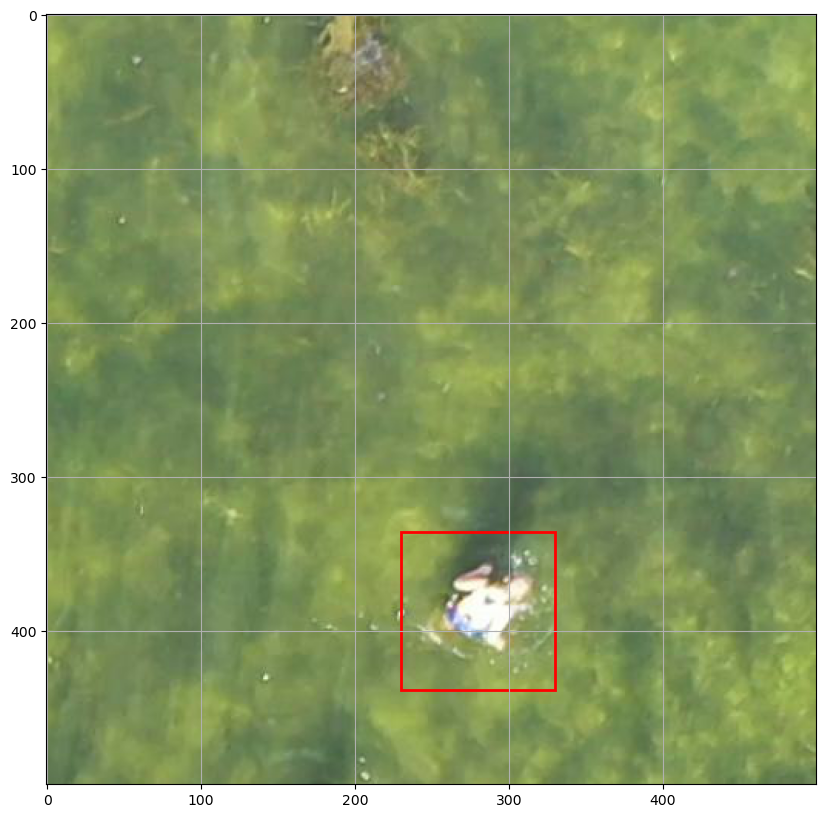

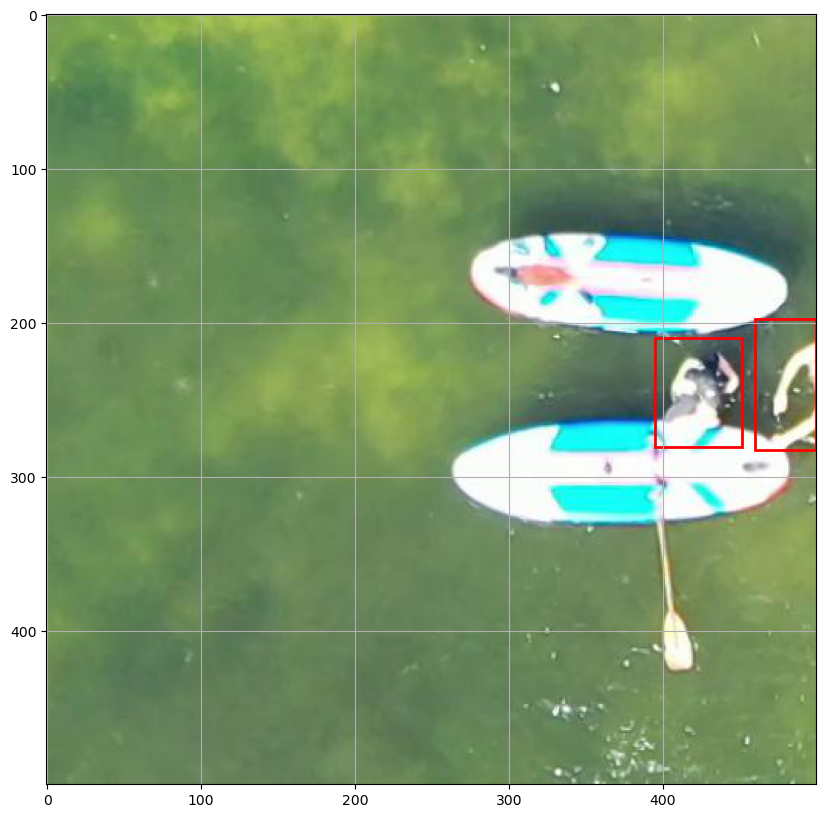

/var/folders/zk/p2gyqg915639vx6xr9xbs9cm0000gn/T/ipykernel_55968/3686379391.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_scaled[['x1', 'w']] = df_scaled[['x1', 'w']] * imr.shape[1]
/var/folders/zk/p2gyqg915639vx6xr9xbs9cm0000gn/T/ipykernel_55968/3686379391.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_scaled[['y1', 'h']] = df_scaled[['y1', 'h']] * imr.shape[0]


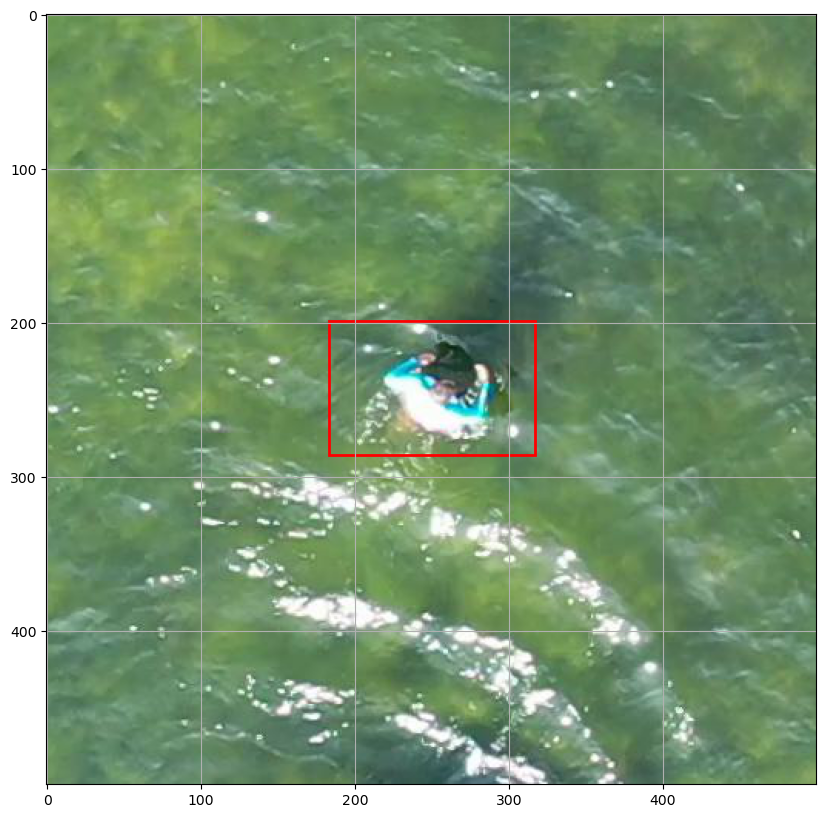

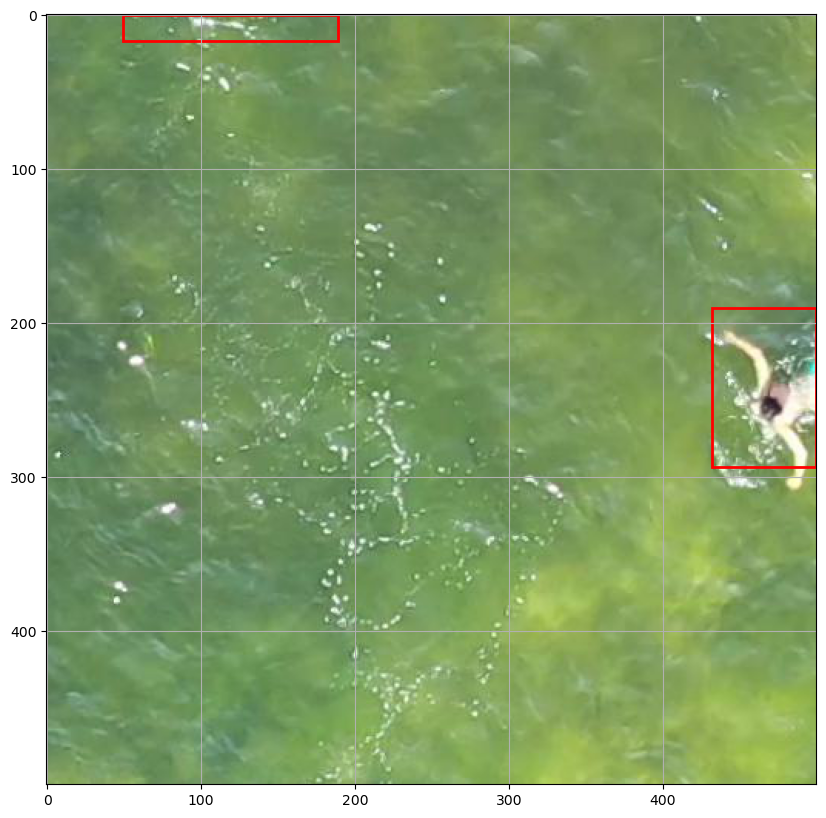

In [122]:
Dont run unless needed
for imname in glob.glob(root_path+'tiledv4/train/ts/*.jpg'):
    im = Image.open(imname)
    imr = np.array(im, dtype=np.uint8)

    labname = imname.replace('.jpg', '.txt')
    df = pd.read_csv(labname, sep=' ', names=['class', 'x1', 'y1', 'w', 'h'])

    df_scaled = df.iloc[:, 1:]
    df_scaled[['x1', 'w']] = df_scaled[['x1', 'w']] * imr.shape[1]
    df_scaled[['y1', 'h']] = df_scaled[['y1', 'h']] * imr.shape[0]

    fig,ax = plt.subplots(1, figsize=(10,10))# Display the image
    ax.imshow(imr)
    for box in df_scaled.values:
        # Create a Rectangle patch
        rect = patches.Rectangle((box[0]-(box[2]/2),box[1]-(box[3]/2)),box[2],box[3],linewidth=2,edgecolor='r',facecolor='none')# Add the patch to the axes
        ax.add_patch(rect)
    plt.grid(alpha = 1)    
    plt.show()

In [131]:
if 0!=0:
    print('hi')

UsageError: Cell magic `%%cache` not found.
